# Data Inspection

In [1]:
import plotly
plotly.offline.init_notebook_mode()

In [1]:
import pandas as pd
from tqdm import tqdm

df_list = list()
chunk_iter = pd.read_csv(
    "../data/Total_Data_10Y_Top24.csv", 
    chunksize=100000, 
    dtype = {
        "CANCELLATION_CODE": str,
    }
)
for chunk in tqdm(chunk_iter):
    df_list.append(chunk)
df = pd.concat(df_list)
df.head()

130it [00:28,  4.60it/s]


,FL_DATE,OP_UNIQUE_CARRIER,TAIL_NUM,ORIGIN_AIRPORT_SEQ_ID,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,DEST_AIRPORT_SEQ_ID,DEST_CITY_MARKET_ID,DEST,...,TAXI_IN,ARR_TIME,ARR_DELAY,CANCELLED,CANCELLATION_CODE,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY
0,2014-07-01,AA,N002AA,1105703,31057,CLT,"Charlotte, NC",1129803,30194,DFW,...,28.0,1214.0,9.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN
1,2014-07-01,AA,N002AA,1129803,30194,DFW,"Dallas/Fort Worth, TX",1105703,31057,CLT,...,13.0,945.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN
2,2014-07-01,AA,N004AA,1039705,30397,ATL,"Atlanta, GA",1129803,30194,DFW,...,6.0,1341.0,-9.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN
3,2014-07-01,AA,N004AA,1129803,30194,DFW,"Dallas/Fort Worth, TX",1039705,30397,ATL,...,7.0,1159.0,4.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN
4,2014-07-01,AA,N004AA,1129803,30194,DFW,"Dallas/Fort Worth, TX",1039705,30397,ATL,...,6.0,2317.0,2.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN


# Data Cleaning

In [2]:
df.columns

Index(['FL_DATE', 'OP_UNIQUE_CARRIER', 'TAIL_NUM', 'ORIGIN_AIRPORT_SEQ_ID',
       'ORIGIN_CITY_MARKET_ID', 'ORIGIN', 'ORIGIN_CITY_NAME',
       'DEST_AIRPORT_SEQ_ID', 'DEST_CITY_MARKET_ID', 'DEST', 'DEST_CITY_NAME',
       'DEP_TIME', 'DEP_DELAY', 'TAXI_OUT', 'TAXI_IN', 'ARR_TIME', 'ARR_DELAY',
       'CANCELLED', 'CANCELLATION_CODE', 'CARRIER_DELAY', 'WEATHER_DELAY',
       'NAS_DELAY', 'SECURITY_DELAY', 'LATE_AIRCRAFT_DELAY'],
      dtype='object')

In [3]:
import matplotlib.pyplot as plt
from datetime import time

target_df = df.drop(columns = [
    "TAIL_NUM",
    "ORIGIN_AIRPORT_SEQ_ID",
    "ORIGIN_CITY_MARKET_ID",
    "ORIGIN",
    "ORIGIN_CITY_NAME",
    "DEST_AIRPORT_SEQ_ID",
    "DEST_CITY_MARKET_ID",
    "DEST",
    "DEST_CITY_NAME",
    "DEP_TIME",
    "TAXI_OUT",
    "TAXI_IN",
    "ARR_TIME",
])
del df

In [4]:
target_df['FL_DATE'] = pd.to_datetime(target_df['FL_DATE'])

In [29]:
airline_names = pd.read_csv("../supplementary/top_18_airline_review_link.csv")
airline_names

,index,OP_UNIQUE_CARRIER,count,CARRIER,CARRIERNAME,matched_name,urls
0,15,WN,63426,WN,Southwest Airlines Co.,Southwest Airlines,https://www.airlinequality.com/airline-reviews...
1,4,DL,43959,DL,Delta Air Lines Inc.,Delta Air Lines,https://www.airlinequality.com/airline-reviews...
2,1,AA,41637,AA,American Airlines Inc.,American Airlines,https://www.airlinequality.com/airline-reviews...
3,12,OO,34846,OO,SkyWest Airlines Inc.,SkyWest Airlines,https://www.airlinequality.com/airline-reviews...
4,14,UA,28030,UA,United Air Lines Inc.,United Airlines,https://www.airlinequality.com/airline-reviews...
5,3,B6,12805,B6,JetBlue Airways,Jetblue Airways,https://www.airlinequality.com/airline-reviews...
6,9,MQ,10950,MQ,Envoy Air,American Eagle,https://www.airlinequality.com/airline-reviews...
7,5,EV,10680,EV,ExpressJet Airlines LLC d/b/a aha!,NaN,NaN
8,2,AS,9965,AS,Alaska Airlines Inc.,Alaska Airlines,https://www.airlinequality.com/airline-reviews...
9,17,YX,9672,YX,Republic Airline,NaN,NaN


In [64]:
airport_set_df = target_df.OP_UNIQUE_CARRIER.drop_duplicates()
airport_review = pd.read_csv("../supplementary/Airline-Reviews-Table.csv")
airport_review = airport_review[airport_review.AIRLINE_CODE.isin(airport_set_df)]

airport_default_score = airport_review.groupby("AIRLINE_CODE")[[
    'ratingValue',
    'seatComfort', 
    'foodBeverage', 
    'cabinService', 
    'inflightEntertainment', 
    'wifiConnectivity', 
    'groundService', 
    'valueForMoney',
    'sentiment'
]].mean().reset_index()

airport_review_count = airport_review.groupby("AIRLINE_CODE").size().reset_index().rename(columns = {0:"reviewCount"})
airport_review_merged = pd.merge(airport_review_count, airport_default_score, how = "inner", on = "AIRLINE_CODE")
airport_review_merged = pd.merge(airport_review_merged, airline_names, how = "inner", left_on = "AIRLINE_CODE", right_on = "OP_UNIQUE_CARRIER")
airport_review_merged.head()

C:\Users\wongh\AppData\Local\Temp\ipykernel_19840\2395432350.py:2: DtypeWarning:

Columns (14) have mixed types. Specify dtype option on import or set low_memory=False.



,AIRLINE_CODE,reviewCount,ratingValue,seatComfort,foodBeverage,cabinService,inflightEntertainment,wifiConnectivity,groundService,valueForMoney,sentiment,index,OP_UNIQUE_CARRIER,count,CARRIER,CARRIERNAME,matched_name,urls
0,9E,2667,0.357593,2.567887,2.569762,2.851837,2.887197,2.320190,2.324231,2.224681,-0.432321,0,9E,7558,9E,Endeavor Air Inc.,Delta Air Lines,https://www.airlinequality.com/airline-reviews...
1,AA,5000,0.214920,1.960084,1.860507,2.159644,1.973280,1.692893,1.638175,1.591600,-0.785200,1,AA,41637,AA,American Airlines Inc.,American Airlines,https://www.airlinequality.com/airline-reviews...
2,AS,794,0.376952,2.656944,2.542751,2.850350,2.487298,2.416867,2.352863,2.287154,-0.400504,2,AS,9965,AS,Alaska Airlines Inc.,Alaska Airlines,https://www.airlinequality.com/airline-reviews...
3,B6,1422,0.279817,2.480945,2.373869,2.474046,2.544898,2.353963,1.906773,1.931083,-0.637131,3,B6,12805,B6,JetBlue Airways,Jetblue Airways,https://www.airlinequality.com/airline-reviews...
4,DL,2667,0.357593,2.567887,2.569762,2.851837,2.887197,2.320190,2.324231,2.224681,-0.432321,4,DL,43959,DL,Delta Air Lines Inc.,Delta Air Lines,https://www.airlinequality.com/airline-reviews...


In [31]:
target_airport_df = pd.merge(
    target_df, 
    airport_review_merged,
    how = "inner", 
    left_on = "OP_UNIQUE_CARRIER", 
    right_on = "AIRLINE_CODE",
    suffixes = ["", "_origin"]
)
target_airport_df = pd.merge(
    target_airport_df,
    airline_names,
    how = "inner",
    on = "OP_UNIQUE_CARRIER",
)
target_airport_df.rename(columns = {
    'reviewCount':'Review Count', 
    'ratingValue':'Rating Value', 
    'seatComfort': "Seat Comfort", 
    'foodBeverage': "Food & Beverage", 
    'cabinService': "Cabin Service", 
    'inflightEntertainment': "Inflight Entertainment", 
    'wifiConnectivity': "Wifi Connectivity", 
    'groundService': "Ground Service", 
    'valueForMoney': "Value for Money",
    'sentiment': "Sentiment"
}, inplace = True)
target_airport_df.drop(columns = ['OP_UNIQUE_CARRIER'], inplace = True)
target_airport_df['CANCELLATION_CODE'] = target_airport_df['CANCELLATION_CODE'].fillna("Not")
target_airport_df.head()

,FL_DATE,DEP_DELAY,ARR_DELAY,CANCELLED,CANCELLATION_CODE,CARRIER_DELAY,WEATHER_DELAY,NAS_DELAY,SECURITY_DELAY,LATE_AIRCRAFT_DELAY,...,Wifi Connectivity,Ground Service,Value for Money,Sentiment,index,count,CARRIER,CARRIERNAME,matched_name,urls
0,2014-07-01,-5.0,9.0,0.0,Not,NaN,NaN,NaN,NaN,NaN,...,1.692893,1.638175,1.5916,-0.7852,1,41637,AA,American Airlines Inc.,American Airlines,https://www.airlinequality.com/airline-reviews...
1,2014-07-01,-4.0,0.0,0.0,Not,NaN,NaN,NaN,NaN,NaN,...,1.692893,1.638175,1.5916,-0.7852,1,41637,AA,American Airlines Inc.,American Airlines,https://www.airlinequality.com/airline-reviews...
2,2014-07-01,-2.0,-9.0,0.0,Not,NaN,NaN,NaN,NaN,NaN,...,1.692893,1.638175,1.5916,-0.7852,1,41637,AA,American Airlines Inc.,American Airlines,https://www.airlinequality.com/airline-reviews...
3,2014-07-01,14.0,4.0,0.0,Not,NaN,NaN,NaN,NaN,NaN,...,1.692893,1.638175,1.5916,-0.7852,1,41637,AA,American Airlines Inc.,American Airlines,https://www.airlinequality.com/airline-reviews...
4,2014-07-01,1.0,2.0,0.0,Not,NaN,NaN,NaN,NaN,NaN,...,1.692893,1.638175,1.5916,-0.7852,1,41637,AA,American Airlines Inc.,American Airlines,https://www.airlinequality.com/airline-reviews...


# Visualization

## Airport Review

First of all, let's have a look at the Review Data we collected

In [8]:
airport_review_merged.head()

,AIRLINE_CODE,reviewCount,ratingValue,seatComfort,foodBeverage,cabinService,inflightEntertainment,wifiConnectivity,groundService,valueForMoney,sentiment
0,9E,2667,0.357593,2.567887,2.569762,2.851837,2.887197,2.320190,2.324231,2.224681,-0.432321
1,AA,5000,0.214920,1.960084,1.860507,2.159644,1.973280,1.692893,1.638175,1.591600,-0.785200
2,AS,794,0.376952,2.656944,2.542751,2.850350,2.487298,2.416867,2.352863,2.287154,-0.400504
3,B6,1422,0.279817,2.480945,2.373869,2.474046,2.544898,2.353963,1.906773,1.931083,-0.637131
4,DL,2667,0.357593,2.567887,2.569762,2.851837,2.887197,2.320190,2.324231,2.224681,-0.432321


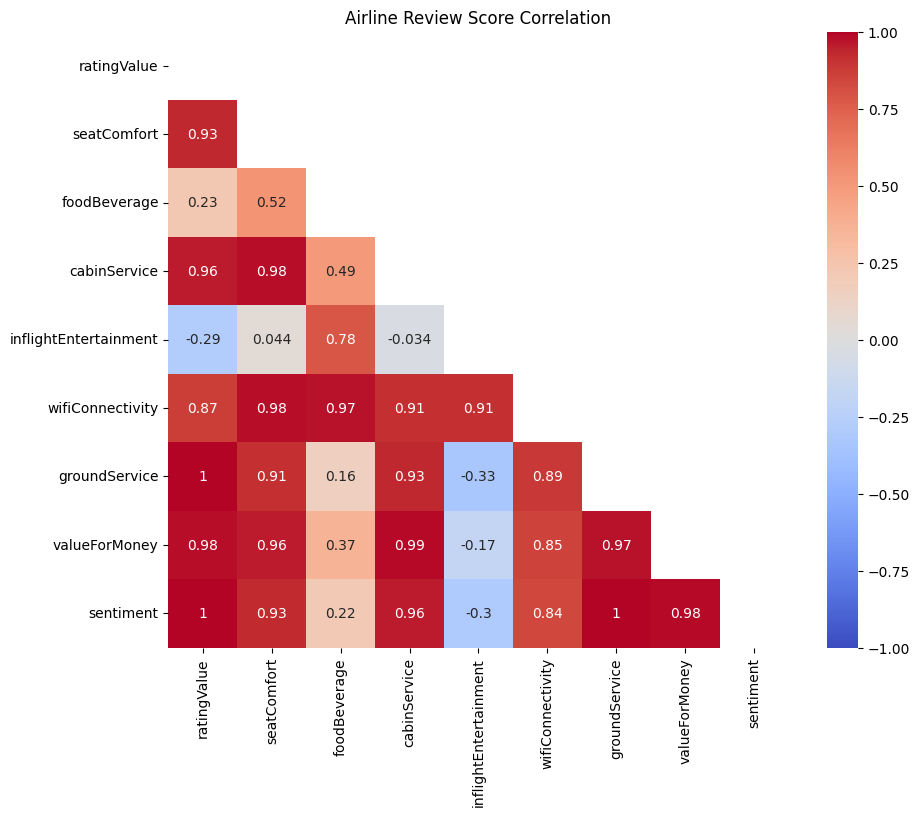

In [23]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

corr_matrix = airport_review_merged.loc[:, 'ratingValue':].corr()
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))

plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', mask = mask, vmin = -1, vmax = 1)
plt.title('Airline Review Score Correlation')
plt.savefig("Airline_Review_Correlation")

***Summary***

The majority of the score given by users are very correlated, \
with the exception of `reviewCount` of an airport, which inversely correlate with all other attributes.

## Airport Ranking

In [12]:
import pandas as pd
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots 

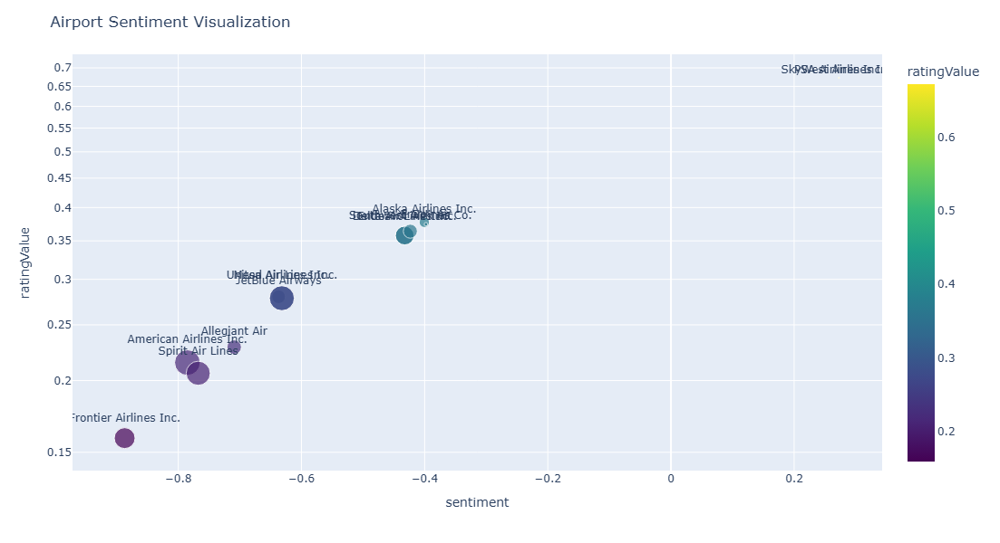

In [65]:
fig = go.Figure()

fig = px.scatter(
    data_frame = airport_review_merged,
    x='sentiment', 
    y='ratingValue',
    color='ratingValue',
    size = 'reviewCount',
    color_continuous_scale = 'viridis',
    text='CARRIERNAME',
    log_y = True
)
fig.update_traces(textposition='top center')
fig.for_each_annotation(
    lambda a: a.update(text= "Medium Airport" if a.text == "Large=False" else "Large Airport")
)
fig.update_layout(
    height=600, 
    width=1000, 
    title_text="Airport Sentiment Visualization", 
    showlegend=False
)
fig.show()

In [16]:
airport_review_merged

,AIRLINE_CODE,reviewCount,ratingValue,seatComfort,foodBeverage,cabinService,inflightEntertainment,wifiConnectivity,groundService,valueForMoney,sentiment
10,OO,11,0.672727,3.272727,1.833333,3.545455,0.750000,NaN,4.142857,3.090909,0.272727
9,OH,11,0.672727,3.272727,1.833333,3.545455,0.750000,NaN,4.142857,3.090909,0.272727
2,AS,794,0.376952,2.656944,2.542751,2.850350,2.487298,2.416867,2.352863,2.287154,-0.400504
0,9E,2667,0.357593,2.567887,2.569762,2.851837,2.887197,2.320190,2.324231,2.224681,-0.432321
4,DL,2667,0.357593,2.567887,2.569762,2.851837,2.887197,2.320190,2.324231,2.224681,-0.432321
3,B6,1422,0.279817,2.480945,2.373869,2.474046,2.544898,2.353963,1.906773,1.931083,-0.637131
12,WN,1498,0.363818,2.465083,2.495513,2.859307,2.282158,2.291667,2.362932,2.362725,-0.423231
7,MQ,93,0.374194,2.434783,2.444444,2.869565,1.466667,1.968750,2.252747,2.290323,-0.397849
13,YV,4749,0.278164,2.135070,2.014809,2.398683,2.117772,1.797923,1.925506,1.883344,-0.631923
11,UA,4749,0.278227,2.134851,2.015647,2.399780,2.118077,1.797923,1.925506,1.883765,-0.631501


## Review Performance per Airport

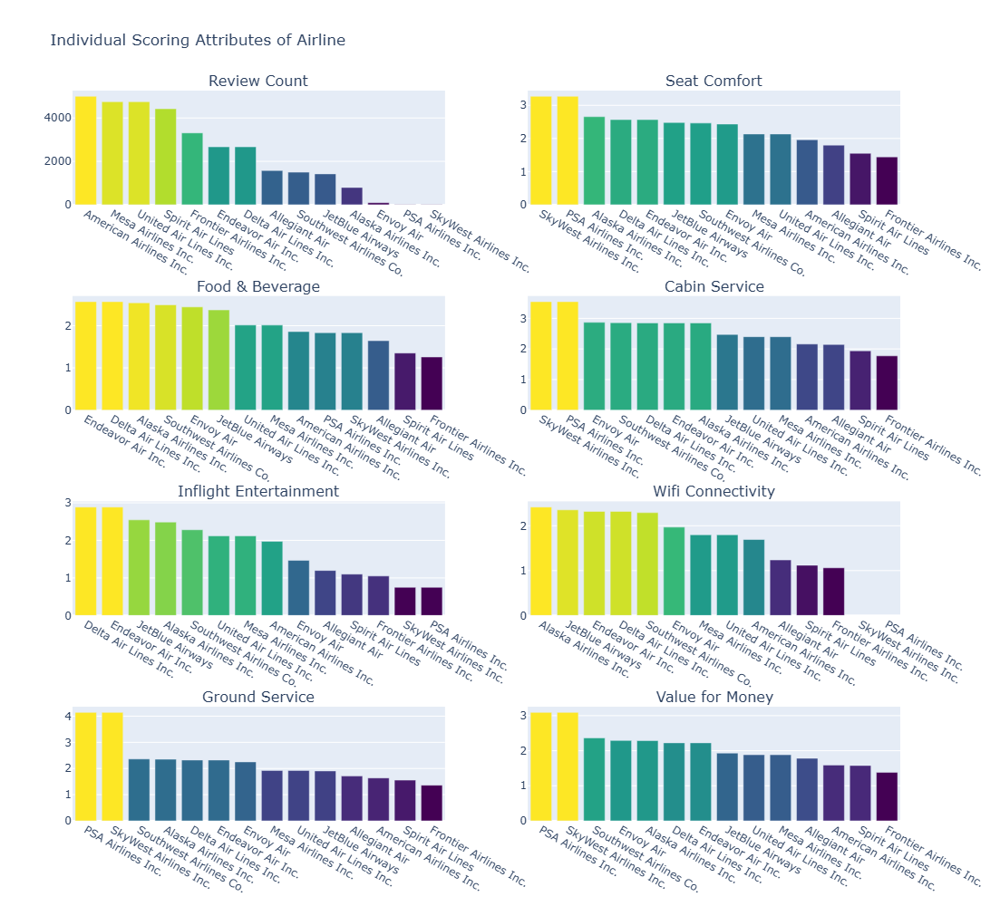

In [66]:
df_columns = [
    'reviewCount',
    'seatComfort', 
    'foodBeverage', 
    'cabinService', 
    'inflightEntertainment', 
    'wifiConnectivity', 
    'groundService', 
    'valueForMoney',
    
]
df_better_names = [
    "Review Count",
    "Seat Comfort", 
    "Food & Beverage", 
    "Cabin Service", 
    "Inflight Entertainment", 
    "Wifi Connectivity", 
    "Ground Service", 
    "Value for Money",
    
]
fig = make_subplots(rows=4, cols=2, subplot_titles=df_better_names)
col = [1, 2]*4
row = [1, 1, 2, 2, 3, 3, 4, 4]
for c, r, column, better_column in zip(col, row, df_columns, df_better_names):
    airport_review_merged.sort_values(column, ascending = False, inplace = True)
    trace = go.Bar(
        x=airport_review_merged['CARRIERNAME'], 
        y=airport_review_merged[column],
        marker=dict(
            color = airport_review_merged[column],
            colorscale='viridis'
        )
    )
    fig.add_trace(
        trace, 
        row=r, 
        col=c
    )
fig.update_layout(
    height=1000, 
    title_text="Individual Scoring Attributes of Airline",
    showlegend=False
)
fig.show()

## Delay vs Ranking

In [32]:
target_airport_df.columns

Index(['FL_DATE', 'DEP_DELAY', 'ARR_DELAY', 'CANCELLED', 'CANCELLATION_CODE',
       'CARRIER_DELAY', 'WEATHER_DELAY', 'NAS_DELAY', 'SECURITY_DELAY',
       'LATE_AIRCRAFT_DELAY', 'AIRLINE_CODE', 'Review Count', 'Rating Value',
       'Seat Comfort', 'Food & Beverage', 'Cabin Service',
       'Inflight Entertainment', 'Wifi Connectivity', 'Ground Service',
       'Value for Money', 'Sentiment', 'index', 'count', 'CARRIER',
       'CARRIERNAME', 'matched_name', 'urls'],
      dtype='object')

In [59]:
train_columns = [
    'Rating Value',
    'Seat Comfort',
    'Food & Beverage',
    'Cabin Service',
    'Inflight Entertainment',
    'Wifi Connectivity',
    'Ground Service',
    'Value for Money',
    'Sentiment'
]
label_columns = [
    "DEP_DELAY",
    "ARR_DELAY",
    "CARRIER_DELAY",
    "WEATHER_DELAY",
    "NAS_DELAY",
    "SECURITY_DELAY",
    "LATE_AIRCRAFT_DELAY",
]

***Delay Data Size >0***

In [51]:
cal_df = target_airport_df[['CARRIERNAME'] + label_columns]
delay = cal_df.groupby('CARRIERNAME')[label_columns].apply(lambda x: (x > 0).mean()*100).reset_index().sort_values("ARR_DELAY", ascending = True)
big_delay = cal_df.groupby('CARRIERNAME')[label_columns].apply(lambda x: (x > 60).mean()*100).reset_index().sort_values("ARR_DELAY", ascending = True)

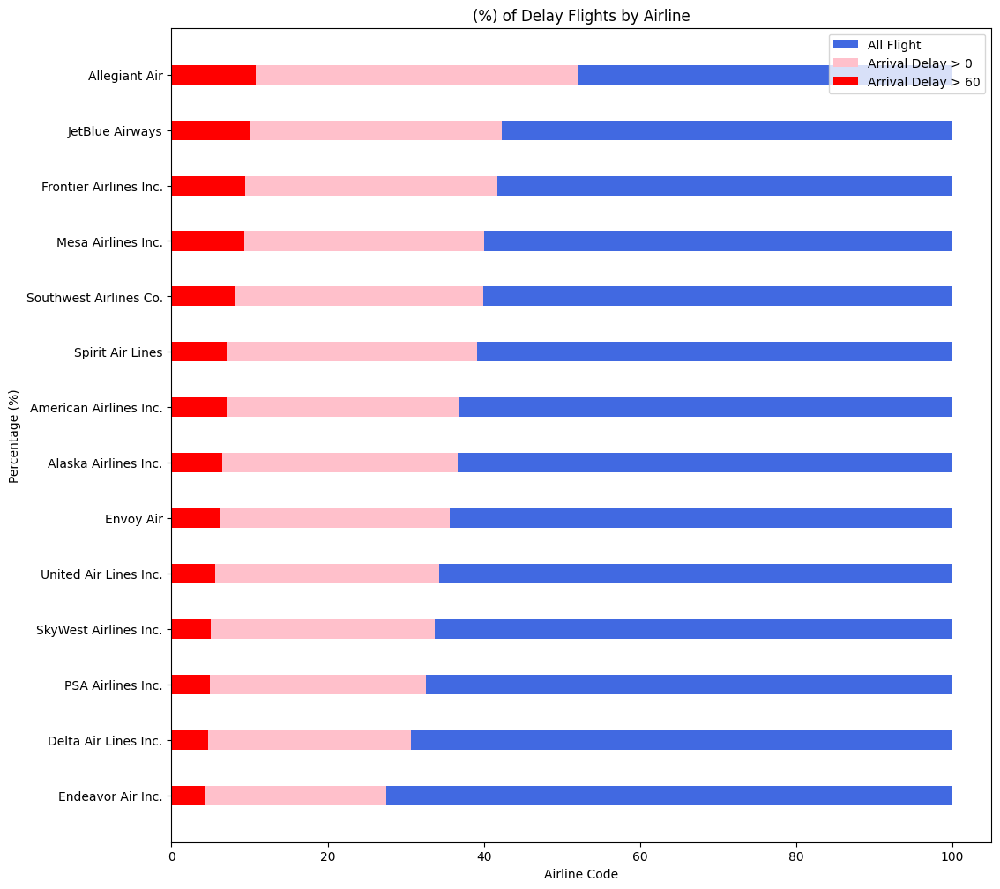

In [54]:
import pandas as pd
import matplotlib.pyplot as plt

df1 = delay
df2 = big_delay

fig, ax = plt.subplots(figsize=(12, 12))

bar_width = 0.35
index = range(len(df1))
bars3 = ax.barh([i for i in index], [100 for _ in range(len(df2['ARR_DELAY']))], bar_width, label='All Flight', color='royalblue')
bars1 = ax.barh(index, df1['ARR_DELAY'], bar_width, label='Arrival Delay > 0', color='pink')
bars2 = ax.barh([i for i in index], df2['ARR_DELAY'], bar_width, label='Arrival Delay > 60', color='red')


# Adding labels, title, and legend
ax.set_xlabel('Airline Code')
ax.set_ylabel('Percentage (%)')
ax.set_title('(%) of Delay Flights by Airline')
ax.set_yticks([i  for i in index])
ax.set_yticklabels(df1['CARRIERNAME'], rotation=0)
ax.legend()

plt.savefig("Delay_by_Airline")

In [13]:
target_airport_df.columns

Index(['FL_DATE', 'ORIGIN_CITY_MARKET_ID', 'ORIGIN', 'ORIGIN_CITY_NAME',
       'DEST_CITY_MARKET_ID', 'DEST', 'DEST_CITY_NAME', 'DEP_DELAY',
       'ARR_DELAY', 'CANCELLED', 'CANCELLATION_CODE', 'CARRIER_DELAY',
       'WEATHER_DELAY', 'NAS_DELAY', 'SECURITY_DELAY', 'LATE_AIRCRAFT_DELAY',
       'Origin Review Count', 'Origin Rating Value', 'Origin Queue Time',
       'Origin Terminal Cleanliness', 'Origin Terminal Seating',
       'Origin Terminal Sign', 'Origin Food Beverage',
       'Origin Airport Shopping', 'Origin Wifi Connectivity',
       'Origin Airport Staff', 'Origin Sentiment', 'Origin Busy',
       'Destination Review Count', 'Destination Rating Value',
       'Destination Queue Time', 'Destination Terminal Cleanliness',
       'Destination Terminal Seating', 'Destination Terminal Sign',
       'Destination Food Beverage', 'Destination Airport Shopping',
       'Destination Wifi Connectivity', 'Destination Airport Staff',
       'Destination Sentiment', 'Destination Busy'

In [51]:
target_airport_df = target_airport_df[(target_airport_df['FL_DATE'].dt.month >= 5) & (target_airport_df['FL_DATE'].dt.month <= 8)]
target_airport_df.nunique()

FL_DATE                             1230
ORIGIN_CITY_MARKET_ID                 20
ORIGIN                                24
ORIGIN_CITY_NAME                      24
DEST_CITY_MARKET_ID                   20
DEST                                  24
DEST_CITY_NAME                        24
DEP_TIME                            1440
DEP_DELAY                           1513
ARR_TIME                            1440
ARR_DELAY                           1563
CANCELLED                              2
CANCELLATION_CODE                      5
CARRIER_DELAY                       1317
WEATHER_DELAY                        716
NAS_DELAY                            684
SECURITY_DELAY                       200
LATE_AIRCRAFT_DELAY                 1063
Origin Review Count                   23
Origin Rating Value                   24
Origin Queue Time                     24
Origin Terminal Cleanliness           23
Origin Terminal Seating               24
Origin Terminal Sign                  24
Origin Food Beve

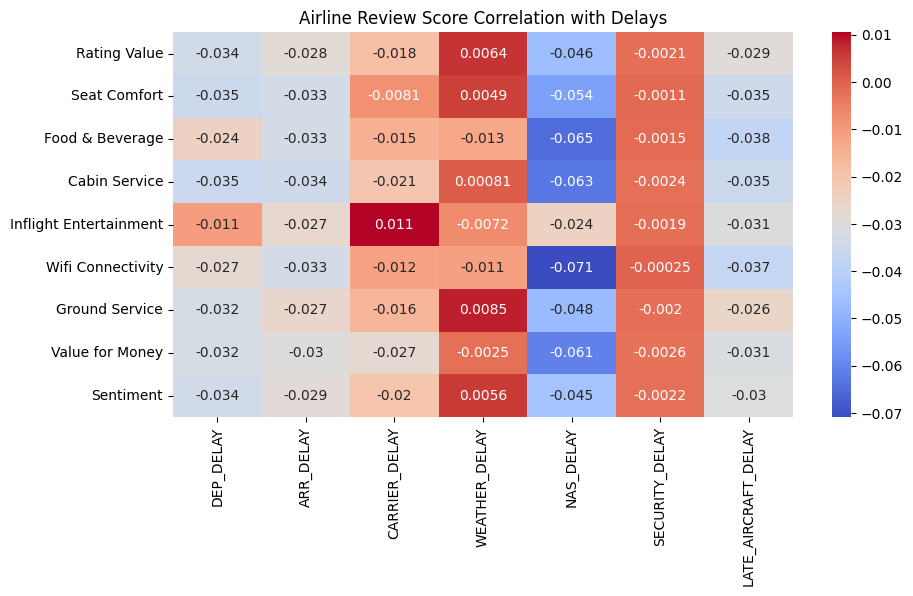

In [60]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

corr_matrix = target_airport_df.loc[:, train_columns + label_columns].corr()

plt.figure(figsize=(10, 5))
sns.heatmap(corr_matrix.loc[train_columns, label_columns], annot=True, cmap='coolwarm')
plt.title('Airline Review Score Correlation with Delays')
plt.savefig("Airline Review Correlation with Delay")


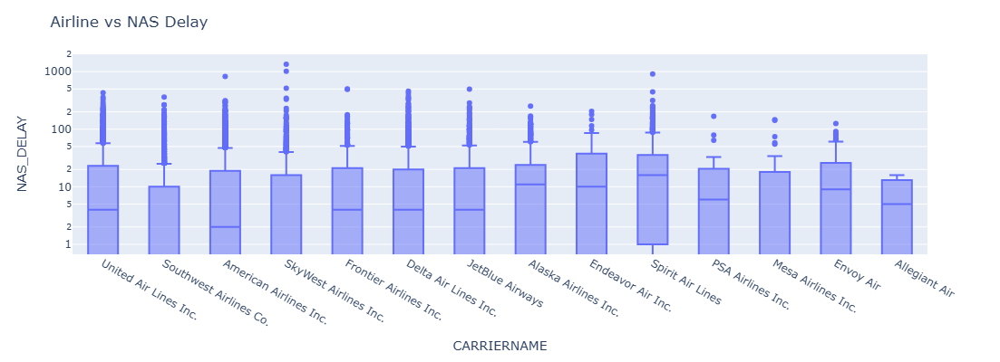

In [63]:
import plotly.express as px

fig = px.box(
    target_airport_df.sample(100000, replace = False).sort_values(["NAS_DELAY"]), 
    x="CARRIERNAME", 
    y="NAS_DELAY",
    log_y = True,
    color_discrete_map = {True: 'red', False: 'blue'}
)
fig.update_layout(
    height=400, 
    title_text=f"Airline vs NAS Delay",
    showlegend=True
)
fig.show()

## Departure Delay Airport Route

In [56]:
target_airport_df

,FL_DATE,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,DEST_CITY_MARKET_ID,DEST,DEST_CITY_NAME,DEP_TIME,DEP_DELAY,ARR_TIME,...,Destination Terminal Cleanliness,Destination Terminal Seating,Destination Terminal Sign,Destination Food Beverage,Destination Airport Shopping,Destination Wifi Connectivity,Destination Airport Staff,Destination Sentiment,Destination Busy,Route
0,2014-07-01,31057,CLT,"Charlotte, NC",30194,DFW,"Dallas/Fort Worth, TX",1025.0,-5.0,1214.0,...,2.908046,2.771429,2.812865,2.179191,2.793478,2.647619,2.102564,-0.531429,True,"Charlotte, NC TO Dallas/Fort Worth, TX"
1,2014-07-01,30194,DFW,"Dallas/Fort Worth, TX",31057,CLT,"Charlotte, NC",621.0,-4.0,945.0,...,2.349112,2.019481,2.625767,1.951220,2.468468,2.100917,1.947020,-0.715976,True,"Dallas/Fort Worth, TX TO Charlotte, NC"
2,2014-07-01,30397,ATL,"Atlanta, GA",30194,DFW,"Dallas/Fort Worth, TX",1238.0,-2.0,1341.0,...,2.908046,2.771429,2.812865,2.179191,2.793478,2.647619,2.102564,-0.531429,True,"Atlanta, GA TO Dallas/Fort Worth, TX"
3,2014-07-01,30194,DFW,"Dallas/Fort Worth, TX",30397,ATL,"Atlanta, GA",904.0,14.0,1159.0,...,2.750751,2.390511,2.623853,1.784195,2.450777,2.613333,1.754902,-0.741742,True,"Dallas/Fort Worth, TX TO Atlanta, GA"
4,2014-07-01,30194,DFW,"Dallas/Fort Worth, TX",30397,ATL,"Atlanta, GA",2016.0,1.0,2317.0,...,2.750751,2.390511,2.623853,1.784195,2.450777,2.613333,1.754902,-0.741742,True,"Dallas/Fort Worth, TX TO Atlanta, GA"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12130797,2019-07-31,31057,CLT,"Charlotte, NC",31703,EWR,"Newark, NJ",2035.0,245.0,2218.0,...,2.258278,1.988806,2.344595,1.568562,1.817352,1.980000,1.562724,-0.801325,True,"Charlotte, NC TO Newark, NJ"
12130798,2019-07-31,30325,DEN,"Denver, CO",30397,ATL,"Atlanta, GA",1332.0,-3.0,1834.0,...,2.750751,2.390511,2.623853,1.784195,2.450777,2.613333,1.754902,-0.741742,True,"Denver, CO TO Atlanta, GA"
12130799,2019-07-31,30397,ATL,"Atlanta, GA",30325,DEN,"Denver, CO",1342.0,-3.0,1454.0,...,2.536424,2.253731,2.213333,2.006757,2.308511,2.557895,1.934307,-0.761589,True,"Atlanta, GA TO Denver, CO"
12130800,2019-07-31,30325,DEN,"Denver, CO",30397,ATL,"Atlanta, GA",747.0,-3.0,1238.0,...,2.750751,2.390511,2.623853,1.784195,2.450777,2.613333,1.754902,-0.741742,True,"Denver, CO TO Atlanta, GA"


In [16]:
target_airport_df['Route'] = target_airport_df.apply(lambda row: row['ORIGIN_CITY_NAME'] + " -> " + row['DEST_CITY_NAME'], axis = 1)
target_airport_df.head()

,FL_DATE,ORIGIN_CITY_MARKET_ID,ORIGIN,ORIGIN_CITY_NAME,DEST_CITY_MARKET_ID,DEST,DEST_CITY_NAME,DEP_TIME,DEP_DELAY,ARR_TIME,...,Destination Terminal Cleanliness,Destination Terminal Seating,Destination Terminal Sign,Destination Food Beverage,Destination Airport Shopping,Destination Wifi Connectivity,Destination Airport Staff,Destination Sentiment,Destination Busy,Route
0,2014-07-01,31057,CLT,"Charlotte, NC",30194,DFW,"Dallas/Fort Worth, TX",10:25:00,-5.0,12:14:00,...,2.908046,2.771429,2.812865,2.179191,2.793478,2.647619,2.102564,-0.531429,True,"Charlotte, NC -> Dallas/Fort Worth, TX"
1,2014-07-01,30194,DFW,"Dallas/Fort Worth, TX",31057,CLT,"Charlotte, NC",06:21:00,-4.0,09:45:00,...,2.349112,2.019481,2.625767,1.951220,2.468468,2.100917,1.947020,-0.715976,True,"Dallas/Fort Worth, TX -> Charlotte, NC"
2,2014-07-01,30397,ATL,"Atlanta, GA",30194,DFW,"Dallas/Fort Worth, TX",12:38:00,-2.0,13:41:00,...,2.908046,2.771429,2.812865,2.179191,2.793478,2.647619,2.102564,-0.531429,True,"Atlanta, GA -> Dallas/Fort Worth, TX"
3,2014-07-01,30194,DFW,"Dallas/Fort Worth, TX",30397,ATL,"Atlanta, GA",09:04:00,14.0,11:59:00,...,2.750751,2.390511,2.623853,1.784195,2.450777,2.613333,1.754902,-0.741742,True,"Dallas/Fort Worth, TX -> Atlanta, GA"
4,2014-07-01,30194,DFW,"Dallas/Fort Worth, TX",30397,ATL,"Atlanta, GA",20:16:00,1.0,23:17:00,...,2.750751,2.390511,2.623853,1.784195,2.450777,2.613333,1.754902,-0.741742,True,"Dallas/Fort Worth, TX -> Atlanta, GA"


In [17]:
target_airport_df_temp = target_airport_df.groupby('Route').size().reset_index().rename(columns = {0: 'DEP_DELAY'})
target_airport_df_temp.sort_values("DEP_DELAY", ascending = False, inplace = True)
target_airport_df_temp = target_airport_df_temp.iloc[:10, :]

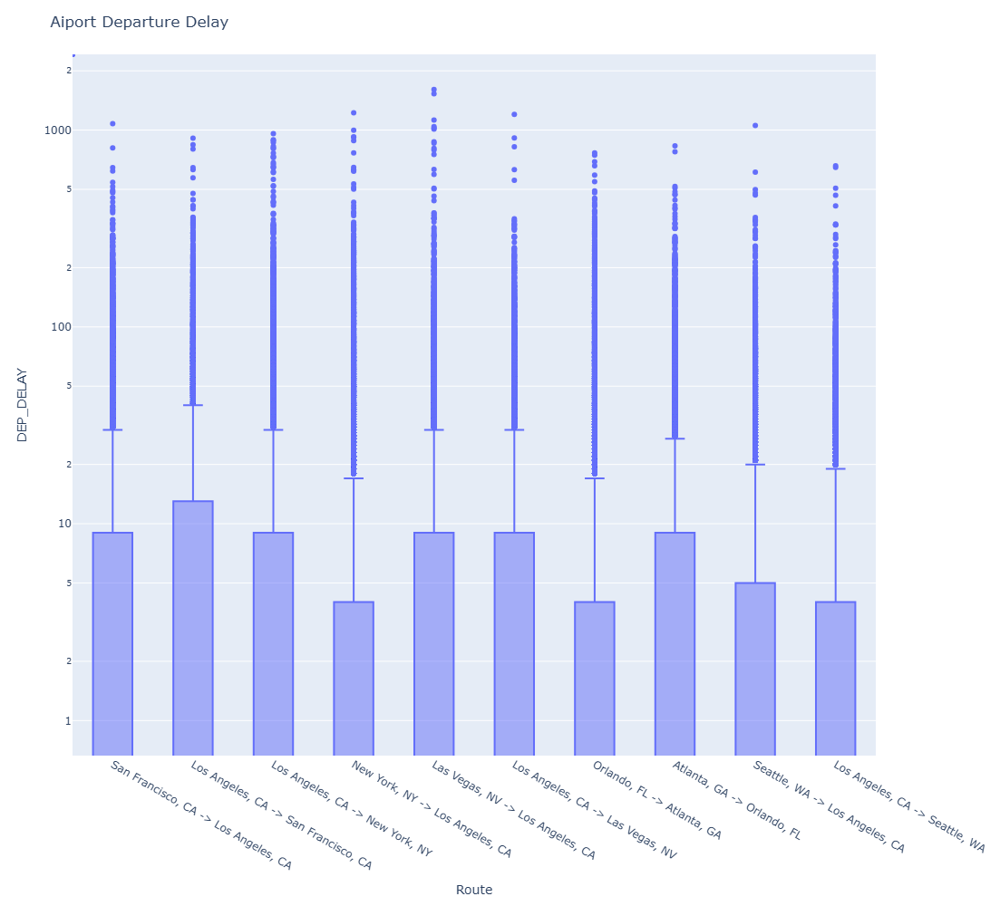

In [18]:
import plotly.express as px
import numpy as np

np.random.seed(1)


top10_busy_route = pd.merge(
    target_airport_df, 
    target_airport_df_temp, 
    how = "inner", 
    on = 'Route', 
    suffixes = ["", "_mean"]
).sample(100000, replace = False)
fig = px.box(
    top10_busy_route.sort_values("DEP_DELAY_mean", ascending = False), 
    x="Route", 
    y="DEP_DELAY",
    log_y = True,
    color_discrete_map = {True: 'red', False: 'blue'}
)
fig.update_layout(
    height=1000, 
    title_text=f"Aiport Departure Delay",
    showlegend=True
)
fig.show()

## Cancelled

In [69]:
train_columns = [
    'Rating Value',
    'Seat Comfort',
    'Food & Beverage',
    'Cabin Service',
    'Inflight Entertainment',
    'Wifi Connectivity',
    'Ground Service',
    'Value for Money',
    'Sentiment'
]
label_columns = [
    "Carrier",
    "Weather",
    "NAS",
    "Security",
    "Not"
]

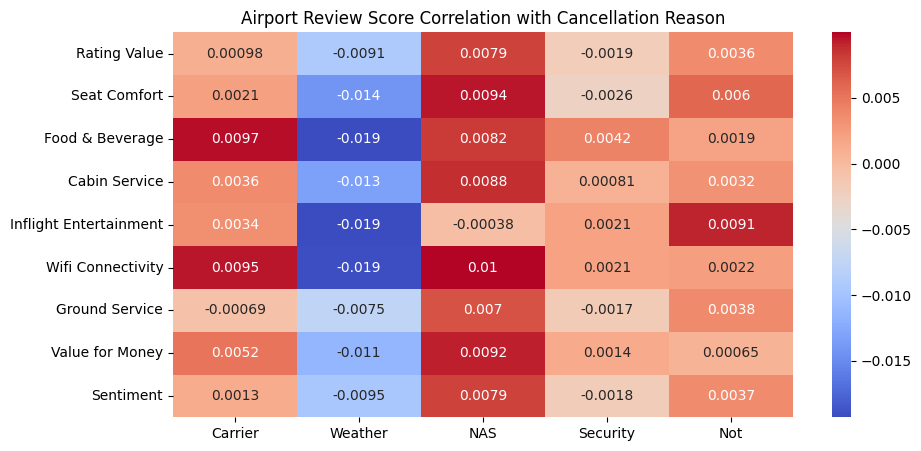

In [70]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

temp = pd.concat([
    target_airport_df, 
    pd.get_dummies(target_airport_df['CANCELLATION_CODE'], prefix = "Cancellation")
], axis = 1)

temp.rename(columns = {
    "Cancellation_A": "Carrier",
    "Cancellation_B": "Weather",
    "Cancellation_C": "NAS",
    "Cancellation_D": "Security",
    "Cancellation_Not": "Not"
}, inplace = True)

corr_matrix = temp.loc[:, train_columns + label_columns].corr()

plt.figure(figsize=(10, 5))
sns.heatmap(corr_matrix.loc[train_columns, label_columns], annot=True, cmap='coolwarm')
plt.title('Airport Review Score Correlation with Cancellation Reason')
plt.show()

In [79]:
hist_df

,CARRIERNAME,CANCELLATION_CODE,Count
0,Alaska Airlines Inc.,A,9946
1,Alaska Airlines Inc.,B,1765
2,Alaska Airlines Inc.,C,1205
3,Alaska Airlines Inc.,D,4
4,Alaska Airlines Inc.,Not,840075
...,...,...,...
64,United Air Lines Inc.,A,9297
65,United Air Lines Inc.,B,10273
66,United Air Lines Inc.,C,1063
67,United Air Lines Inc.,D,6586


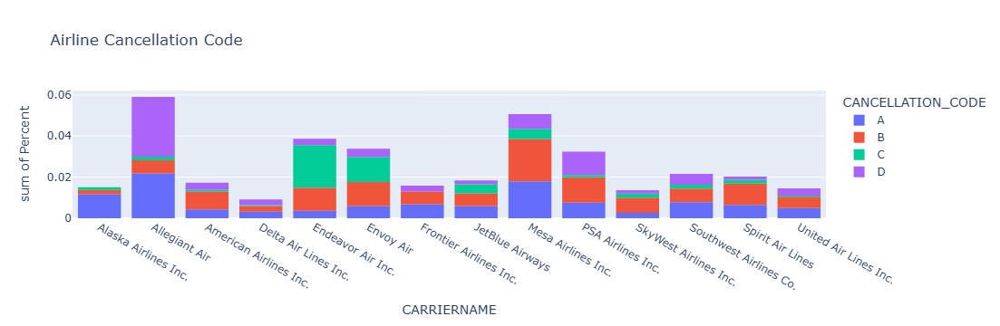

In [88]:
import pandas as pd
import plotly.express as px

hist_df = target_airport_df.groupby(["CARRIERNAME", "CANCELLATION_CODE"]).size().reset_index().rename(columns = {0: "Count"})
count_df = target_airport_df.groupby(["CARRIERNAME"]).size().reset_index().rename(columns = {0: "All_Count"})
hist_df = pd.merge(hist_df, count_df, on = "CARRIERNAME")
hist_df['Percent'] = hist_df.apply(lambda row: row['Count']/row['All_Count'], axis = 1)
hist_df = hist_df[hist_df['CANCELLATION_CODE'] != "Not"]
hist_df.sort_values(["CARRIERNAME", "CANCELLATION_CODE"], inplace = True)
fig = px.histogram(hist_df, x='CARRIERNAME', y='Percent', color='CANCELLATION_CODE' ,title='Airline Cancellation Code')
fig.show()

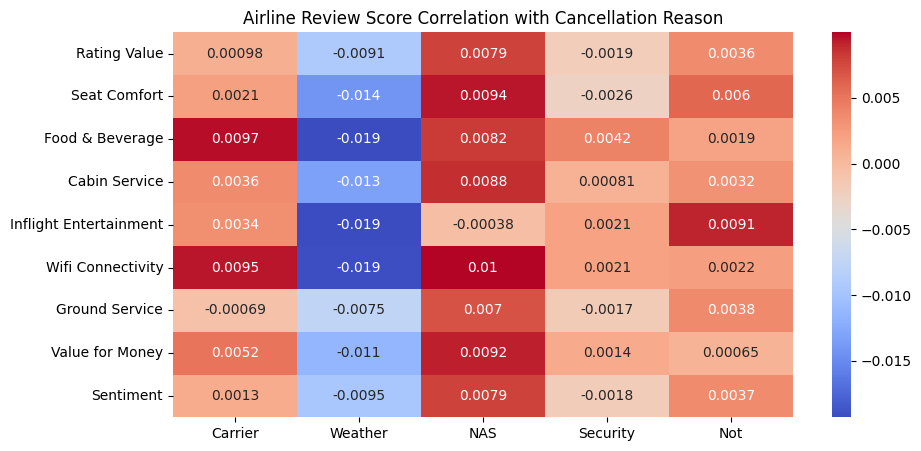

In [72]:
corr_matrix = temp.loc[:, train_columns + label_columns].corr()

plt.figure(figsize=(10, 5))
sns.heatmap(corr_matrix.loc[train_columns, label_columns], annot=True, cmap='coolwarm')
plt.title('Airline Review Score Correlation with Cancellation Reason')
plt.savefig("Airline Review vs Cancellation")

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(12, 12))

bar_width = 0.35
index = range(len(df1))
bars3 = ax.barh([i for i in index], [100 for _ in range(len(df2['ARR_DELAY']))], bar_width, label='All Flight', color='royalblue')
bars1 = ax.barh(index, df1['ARR_DELAY'], bar_width, label='Arrival Delay > 0', color='pink')
bars2 = ax.barh([i for i in index], df2['ARR_DELAY'], bar_width, label='Arrival Delay > 60', color='red')


# Adding labels, title, and legend
ax.set_xlabel('Airline Code')
ax.set_ylabel('Percentage (%)')
ax.set_title('(%) of Delay Flights by Airline')
ax.set_yticks([i  for i in index])
ax.set_yticklabels(df1['CARRIERNAME'], rotation=0)
ax.legend()

plt.savefig("Delay_by_Airline")

In [70]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from tqdm import tqdm
import numpy as np
import math
from sklearn.metrics import confusion_matrix, roc_curve, roc_auc_score
import matplotlib.pyplot as plt
from sklearn.preprocessing import label_binarize

def preprocess(df, y_columns='ARR_DELAY'):
    X = df.loc[:, train_columns]
    y = df.loc[:, y_columns]
    return X, y

In [ ]:
train, test = train_test_split(target_airport_df, test_size=0.2)

In [72]:
train_X, train_y = preprocess(train, "CANCELLATION_CODE")
test_X, test_y = preprocess(test, "CANCELLATION_CODE")

min_max_scaler = preprocessing.MinMaxScaler()
train_X_scaled = min_max_scaler.fit_transform(train_X)
test_X_scaled = min_max_scaler.transform(test_X)

In [73]:
model = LogisticRegression(
    multi_class='ovr', 
    max_iter=1000,
    class_weight="balanced"
)
model.fit(train_X_scaled, train_y)

C:\Users\wongh\anaconda3\envs\601\lib\site-packages\sklearn\linear_model\_logistic.py:1256: FutureWarning:

'multi_class' was deprecated in version 1.5 and will be removed in 1.7. Use OneVsRestClassifier(LogisticRegression(..)) instead. Leave it to its default value to avoid this warning.



LogisticRegression(class_weight='balanced', max_iter=1000, multi_class='ovr')

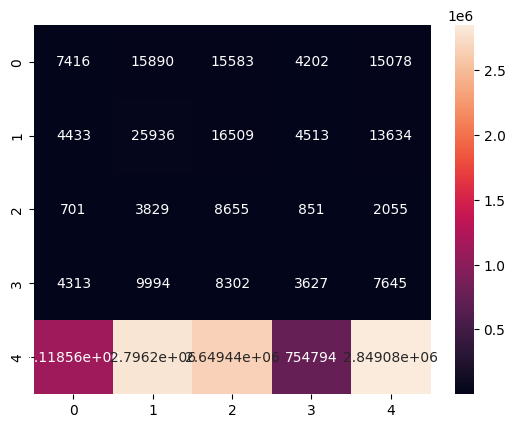

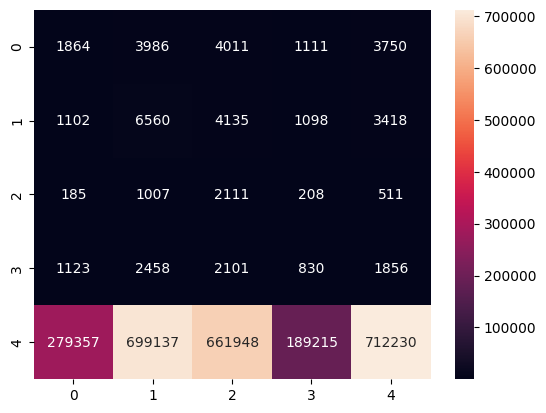

In [74]:
import seaborn as sn
import matplotlib.pyplot as plt

train_predictions = model.predict(train_X_scaled)
test_predictions = model.predict(test_X_scaled)

train_conf_matrix = confusion_matrix(train_y, train_predictions)
test_conf_matrix = confusion_matrix(test_y, test_predictions)

sn.heatmap(train_conf_matrix, annot=True, fmt='g')
plt.show()

sn.heatmap(test_conf_matrix, annot=True, fmt='g')
plt.show()

In [76]:
train_y_encoded = label_binarize(train_y, classes=model.classes_)
test_y_encoded = label_binarize(test_y, classes=model.classes_)

train_probs = model.predict_proba(train_X_scaled)
test_probs = model.predict_proba(test_X_scaled)

fpr_train, tpr_train, _ = roc_curve(train_y_encoded.ravel(), train_probs.ravel())
fpr_test, tpr_test, _ = roc_curve(test_y_encoded.ravel(), test_probs.ravel())

train_auc = roc_auc_score(train_y_encoded, train_probs, average='micro')
test_auc = roc_auc_score(test_y_encoded, test_probs, average='micro')

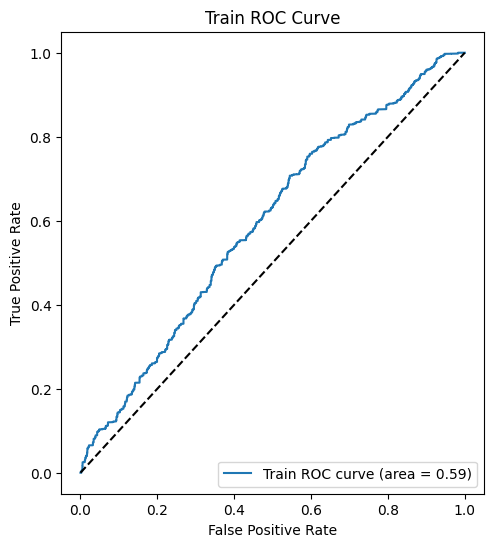

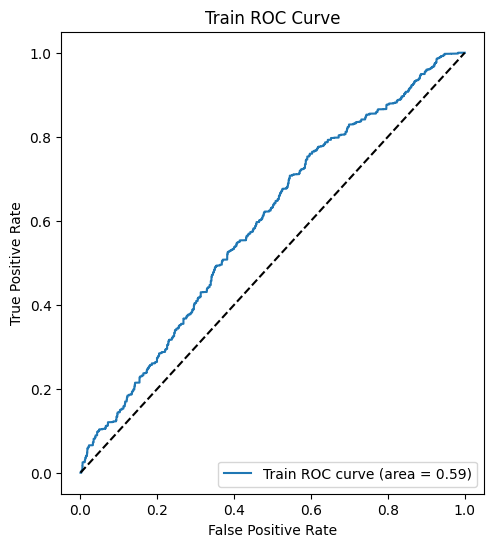

In [77]:
def roc(fpr, tpr, auc):
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(
        fpr, 
        tpr, 
        label=f'Train ROC curve (area = {auc:.2})'
    )
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Train ROC Curve')
    plt.legend(loc="lower right")

roc(fpr_train, tpr_train, train_auc)
roc(fpr_test, tpr_test, test_auc)


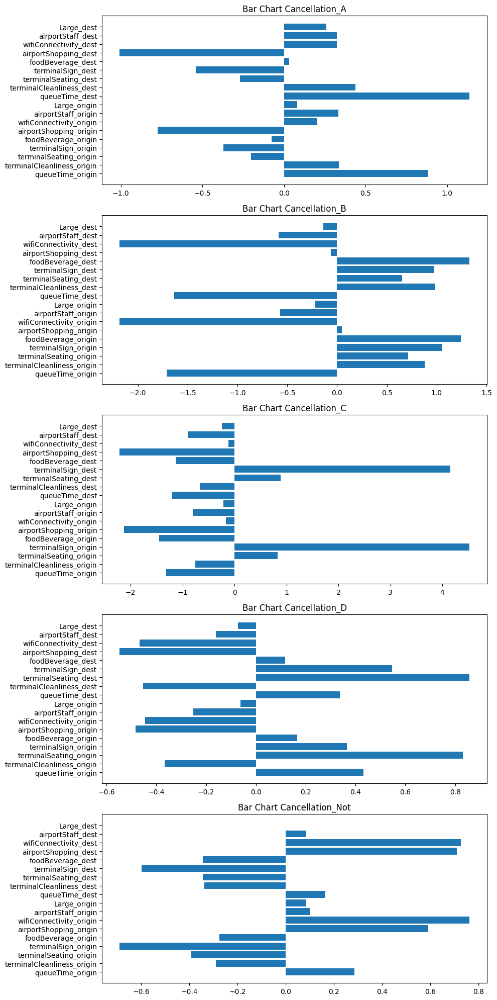

In [78]:
weight = model.coef_

fig, axs = plt.subplots(5, 1, figsize=(10, 20))

for i in range(5):
    ax = axs[i]
    ax.barh(train_columns, weight[i])
    ax.set_title(f'Bar Chart {label_columns[i]}')

plt.tight_layout()
plt.show()

from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from tqdm import tqdm
import numpy as np
import math

def preprocess(df, y_columns = 'ARR_DELAY'):
    df.dropna(subset = y_columns, inplace = True)
    X = df.loc[:, train_columns]
    y = df.loc[:, y_columns]
    return X, y

def experiment(df, y_columns = 'ARR_DELAY'):
    train, test = train_test_split(df, test_size=0.2)

    train_X, train_y = preprocess(train, y_columns)
    test_X, test_y = preprocess(test, y_columns)

    min_max_scaler = preprocessing.MinMaxScaler()
    train_X_scaled = min_max_scaler.fit_transform(train_X)
    test_X_scaled = min_max_scaler.transform(test_X)

    model = LinearRegression()
    model.fit(train_X_scaled, train_y)
    
    train_r_score = model.score(train_X_scaled, train_y)
    test_r_score = model.score(test_X_scaled, test_y)

    return train_r_score, test_r_score, model.coef_

# Redacted

from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from tqdm import tqdm
import numpy as np
import math

def preprocess(df, y_columns = 'ARR_DELAY'):
    df.dropna(subset = y_columns, inplace = True)
    X = df.loc[:, train_columns]
    y = df.loc[:, y_columns]
    return X, y

def experiment(df, y_columns = 'ARR_DELAY'):
    train, test = train_test_split(df, test_size=0.2)

    train_X, train_y = preprocess(train, y_columns)
    test_X, test_y = preprocess(test, y_columns)

    min_max_scaler = preprocessing.MinMaxScaler()
    train_X_scaled = min_max_scaler.fit_transform(train_X)
    test_X_scaled = min_max_scaler.transform(test_X)

    model = LinearRegression()
    model.fit(train_X_scaled, train_y)
    
    train_r_score = model.score(train_X_scaled, train_y)
    test_r_score = model.score(test_X_scaled, test_y)

    return train_r_score, test_r_score, model.coef_
    

### Arrival Delay Reasoning

train_r_list, test_r_list, coef_list = list(), list(), list()
for i in tqdm(range(EXPERIMENT_COUNT)):
    np.random.seed(i)
    train_r_score, test_r_score, coef = experiment(target_airport_df, 'LOG_ARR_DELAY')
    train_r_list.append(train_r_score)
    test_r_list.append(test_r_score)
    coef_list.append(coef)

import plotly.express as px

coef_df_list = list()

for i, array in enumerate(coef_list):
    coef_df = pd.DataFrame({
        "Feature": train_columns,
        "Weight": array
    })
    coef_df_list.append(coef_df)
    
result_df = pd.concat(coef_df_list)

fig = px.box(
    result_df, 
    x="Feature", 
    y="Weight",
)
fig.update_layout(
    height=600, 
    title_text="Aiport Rating vs Arrival Delay",
    showlegend=False
)
fig.show()

In [19]:
train_r_list, test_r_list

([0.0027769056925236457,
  0.002726794565260926,
  0.002739984286952546,
  0.0027382477593851373,
  0.002750673837592532,
  0.0027616015050112575,
  0.002722193250161431,
  0.002763664872232119,
  0.0027681168845542503,
  0.002773670861719535],
 [0.0026226756634710746,
  0.0028214286965265734,
  0.0027696415080686876,
  0.002776677393967586,
  0.0027283399081202697,
  0.0026838710483376715,
  0.0028416825308008598,
  0.0026738151940109978,
  0.00265653353537032,
  0.002636301651983919])

### Departure Delay Reasoning

train_r_list, test_r_list, coef_list = list(), list(), list()
for i in tqdm(range(EXPERIMENT_COUNT)):
    np.random.seed(i)
    train_r_score, test_r_score, coef = experiment(target_airport_df, 'DEP_DELAY')
    train_r_list.append(train_r_score)
    test_r_list.append(test_r_score)
    coef_list.append(coef)

import plotly.express as px

coef_df_list = list()

for i, array in enumerate(coef_list):
    coef_df = pd.DataFrame({
        "Feature": train_columns,
        "Weight": array
    })
    coef_df_list.append(coef_df)
    
result_df = pd.concat(coef_df_list)

fig = px.box(
    result_df, 
    x="Feature", 
    y="Weight",
)
fig.update_layout(
    height=600, 
    title_text="Aiport Rating vs Departure Delay",
    showlegend=False
)
fig.show()

import pandas as pd
import plotly.graph_objects as go
import plotly.express as px

fig = go.Figure()

coef_df.sort_values("Weight", ascending = False, inplace = True)
fig = px.bar(
    data_frame = coef_df,
    x='Feature', 
    y='Weight',
    color='Weight',
    color_continuous_scale = 'viridis',
)
fig.update_layout(
    height=600, 
    width=1000, 
    title_text="Airport Sentiment Visualization", 
    showlegend=False
)
fig.show()

import math

target_airport_df["LOG_ARR_DELAY"] = target_airport_df["ARR_DELAY"].apply(lambda x: 0 if x <= 0 else math.log(x))
target_airport_df["LOG_DEP_DELAY"] = target_airport_df["DEP_DELAY"].apply(lambda x: 0 if x <= 0 else math.log(x))
target_airport_df["LOG_ARR_DELAY"]